In [1]:
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf

from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image

import tensorflow.keras.backend as K
import cv2
import os

In [2]:
model_path = 'model_final_sept'
base_model = tf.keras.models.load_model(model_path)
base_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 255, 255, 320)     4160      
                                                                 
 max_pooling2d (MaxPooling2  (None, 127, 127, 320)     0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 126, 126, 320)     409920    
                                                                 
 dropout (Dropout)           (None, 126, 126, 320)     0         
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 63, 63, 320)       0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 62, 62, 320)       4

In [3]:
model = Model(inputs=base_model.input, outputs=base_model.get_layer('dense_2').output)
last_conv_layer = model.get_layer('conv2d_5').output

In [4]:
test_path = '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped'
test_way_list = []
for address, dirs, files in os.walk(test_path):
    for name in files:
        test_way_list.append(os.path.join(address) + '/' + name)
test_way_list  
#del test_way_list[5]
print(len(test_way_list))
test_way_list = list(pd.Series(test_way_list).sort_values())
test_way_list

25


['/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/01_modern_piatygorsk.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/02_const_pyter_dk_ilicha.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/03_brut_boston_city_hall.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/04_palaty_suzdal.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/05_ampir_spb_dom_so_shpilem.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/06_ind_spb_erichssona.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/07_class_spb_senat.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/08_panelka_13_parkovaya_40_msk.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/cropped/09_xxi_spb_8grannik.jpg',
 '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/croppe

In [5]:
cl_list = ['Modern', 'Constructivism', 'Brutalism', 'Palaty', 'Socialist_classicism','Industrial_XIX', 'Classicism', 'Panelka', 'XXI_century', 'Church', 'Fortification', 'Modern', 
           'Modern', 'Constructivism', 'Brutalism', 'Palaty', 'Socialist_classicism','Industrial_XIX', 'Classicism', 'Panelka', 'XXI_century', 'Church', 'Fortification', 'Constructivism', 'XXI_century']
pred_classes = ['Modern', 'Palaty', 'Brutalism', 'Constructivism', 'Socialist_classicism', 'Industrial_XIX', 'Panelka', 'XXI_century', 'Classicism', 'Church', 'Fortification']

1/1 [==============================] - 0s 65ms/step


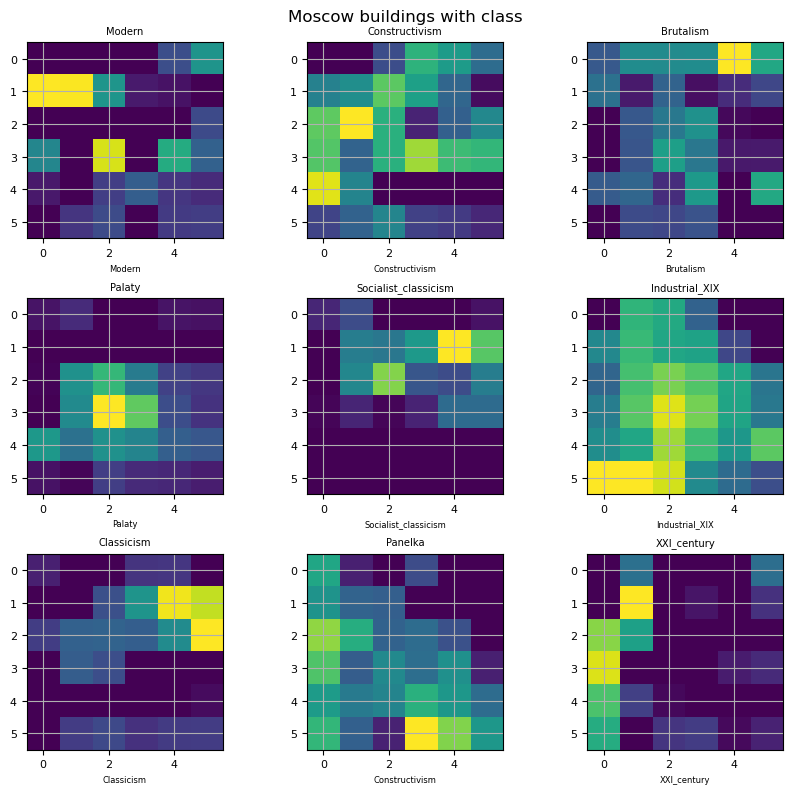

In [6]:
fig = plt.figure(figsize=(10, 8))
plt.suptitle('Moscow buildings with class', size=12)

plt.rc('font', size=6) 
plt.rc('xtick', labelsize=8)    
plt.rc('ytick', labelsize=8) 

for i in range(9):
    fig.add_subplot(3, 3, i+1)

    img = image.load_img(test_way_list[i], target_size=(256, 256))
    #img = image.load_img("/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/01_modern_piatygorsk.jpg", target_size=(256, 256))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    preds = base_model.predict(x)
    class_idx = np.argmax(preds[0])
    cl = pred_classes[class_idx]

    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2))
  
    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    
    plt.imshow(heatmap)
    #plt.imshow(average_heatmap_channels_0_to_5, alpha=0.6, cmap='gist_earth')

    plt.xticks()
    plt.yticks()
    plt.xlabel(cl)
    plt.grid()
    plt.title(cl_list[i])
    plt.tight_layout()

1/1 [==============================] - 0s 68ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 81ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 71ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 71ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 66ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


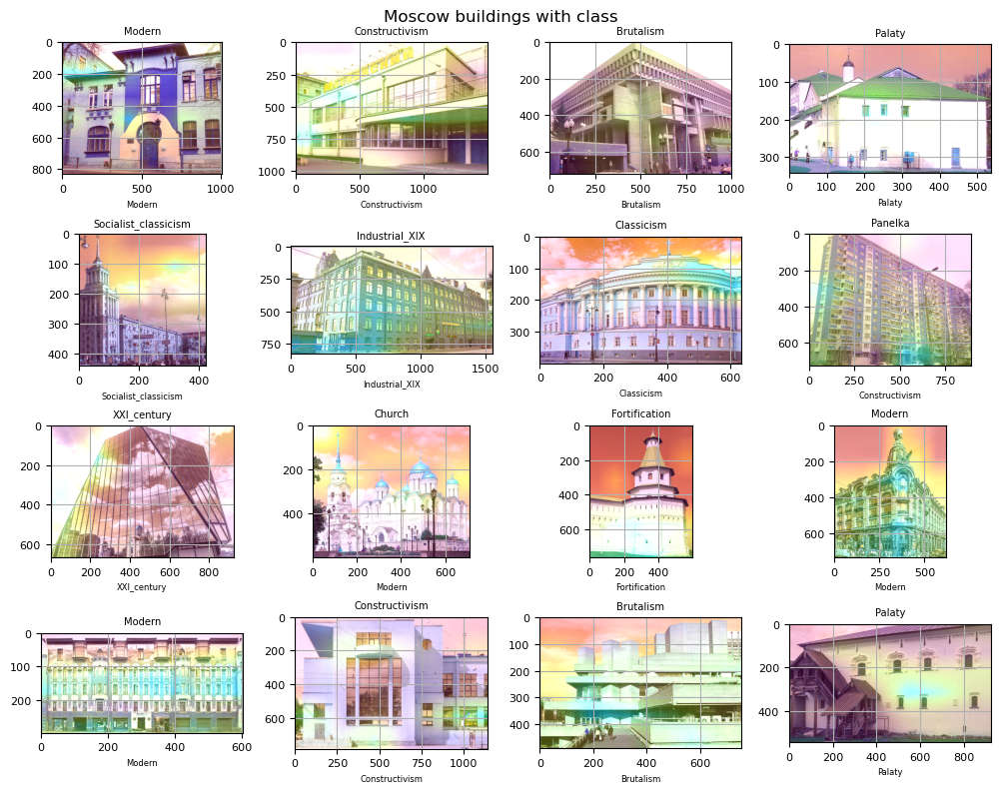

In [7]:
fig = plt.figure(figsize=(10, 8))
plt.suptitle('Moscow buildings with class', size=12)

plt.rc('font', size=6) 
plt.rc('xtick', labelsize=8)    
plt.rc('ytick', labelsize=8) 

for i in range(16):
    fig.add_subplot(4, 4, i+1)

    img = image.load_img(test_way_list[i], target_size=(256, 256))
    #img = image.load_img("/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/arch_tests/01_modern_piatygorsk.jpg", target_size=(256, 256))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    preds = base_model.predict(x)
    class_idx = np.argmax(preds[0])
    cl = pred_classes[class_idx]

    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2))
  
    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    img = cv2.imread(test_way_list[i])
    INTENSITY = 0.5
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_VIRIDIS)
    img2 = heatmap * INTENSITY + img
    
    plt.imshow(img2/255)
    #plt.imshow(average_heatmap_channels_0_to_5, alpha=0.6, cmap='gist_earth')

    plt.xticks()
    plt.yticks()
    plt.xlabel(cl)
    plt.grid()
    plt.title(cl_list[i])
    plt.tight_layout()

1/1 [==============================] - 0s 66ms/step


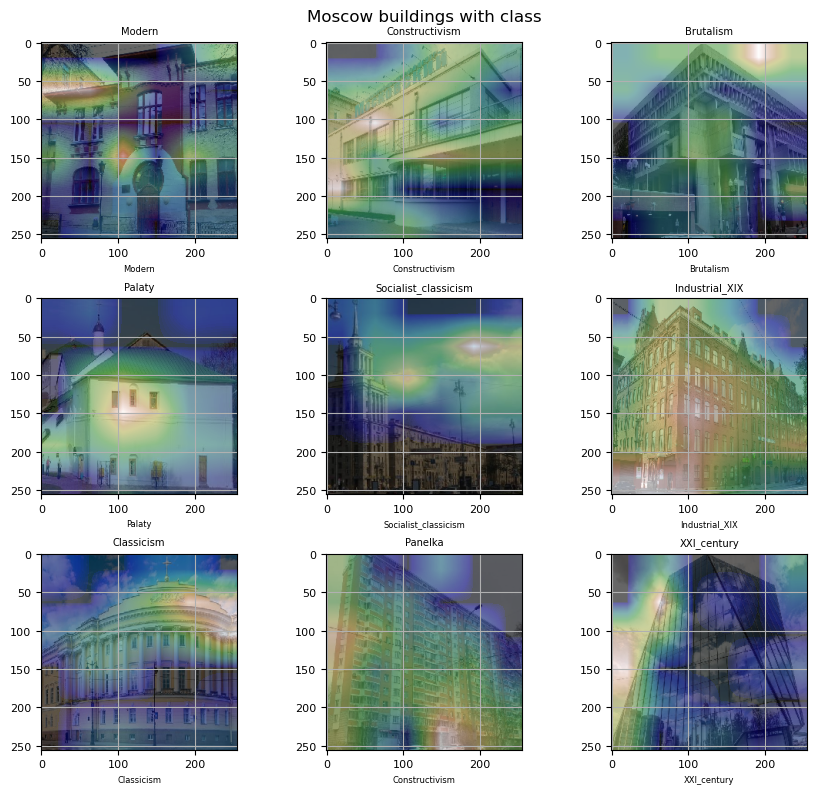

In [8]:
fig = plt.figure(figsize=(10, 8))
plt.suptitle('Moscow buildings with class', size=12)

plt.rc('font', size=6) 
plt.rc('xtick', labelsize=8)    
plt.rc('ytick', labelsize=8) 

for i in range(9):
    fig.add_subplot(3, 3, i+1)

    img = image.load_img(test_way_list[i], target_size=(256, 256))
    
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    preds = base_model.predict(x)
    class_idx = np.argmax(preds[0])
    cl = pred_classes[class_idx]

    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2))
  
    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    img2 = cv2.imread(test_way_list[i])
    INTENSITY = 0.8
    heatmap = cv2.resize(heatmap, (256, 256))
    #heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
    
    plt.imshow(img)
    plt.imshow(heatmap, alpha=0.6, cmap='gist_earth')
    #plt.imshow(average_heatmap_channels_0_to_5, alpha=0.6, cmap='gist_earth')

    plt.xticks()
    plt.yticks()
    plt.xlabel(cl)
    plt.grid()
    plt.title(cl_list[i])
    plt.tight_layout()

# Approach to single image

In [9]:
im_path = test_way_list[10]
img = image.load_img(im_path, target_size=(256, 256))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x.shape

(1, 256, 256, 3)

In [10]:
with tf.GradientTape() as tape:
  last_conv_layer = model.get_layer('conv2d_5')
  iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
  model_out, last_conv_layer = iterate(x)
  class_out = model_out[:, np.argmax(model_out[0])]
  grads = tape.gradient(class_out, last_conv_layer)
  pooled_grads = K.mean(grads, axis=(0, 1, 2))
  
heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
heatmap

<tf.Tensor: shape=(1, 6, 6), dtype=float32, numpy=
array([[[-9.82747879e-04,  9.05268826e-05, -2.04941584e-03,
         -1.04696797e-02, -1.08551476e-02,  1.51872938e-03],
        [-9.12138727e-04, -2.15819618e-03, -4.65937471e-03,
         -1.27746705e-02, -1.90492650e-03,  1.14173004e-02],
        [ 9.78085445e-04,  1.38037857e-02, -7.77536770e-03,
         -6.96947798e-04, -6.38167933e-03, -1.16682779e-02],
        [ 3.72468680e-03,  6.47922140e-03,  2.83293356e-03,
         -9.63450316e-03, -2.28377711e-02, -1.39070153e-02],
        [ 2.62094196e-02,  3.53971496e-02,  4.35011908e-02,
          3.48400474e-02,  3.33949514e-02,  2.98181288e-02],
        [ 3.34206000e-02,  3.31417732e-02,  3.68674695e-02,
          4.04509194e-02,  3.10615040e-02,  2.45712306e-02]]],
      dtype=float32)>

(1, 6, 6)
(6, 6)


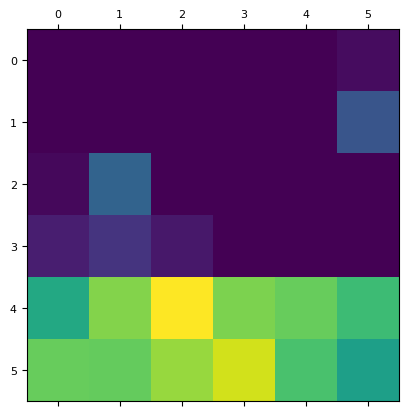

In [11]:
heatmap = np.maximum(heatmap, 0)
print(heatmap.shape)
heatmap /= np.max(heatmap)
heatmap = heatmap.reshape((6, 6))

print(heatmap.shape)
plt.matshow(heatmap)
plt.show()

In [12]:
img = cv2.imread(im_path)
INTENSITY = 0.6
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_VIRIDIS)
img2 = heatmap * INTENSITY + img

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


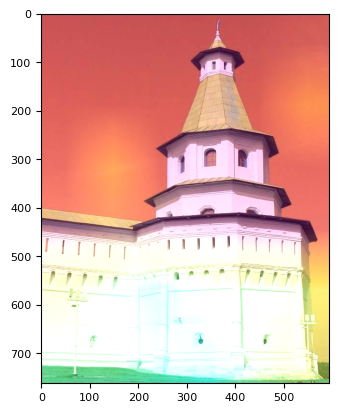

In [13]:
plt.imshow(img2/255)

# Guided Grad-CAM

In [14]:
model_path = '/Users/vladkozlovskiy/Desktop/DATAS/_Architecture_CV/_Mos_arch_final_sept/model_final_sept'
base_model = tf.keras.models.load_model(model_path)
base_model.summary()
model = Model(inputs=base_model.input, outputs=base_model.get_layer('dense_2').output)
last_conv_layer = model.get_layer('conv2d_5').output

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 255, 255, 320)     4160      
                                                                 
 max_pooling2d (MaxPooling2  (None, 127, 127, 320)     0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 126, 126, 320)     409920    
                                                                 
 dropout (Dropout)           (None, 126, 126, 320)     0         
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 63, 63, 320)       0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 62, 62, 320)       4

(1, 256, 256, 3)


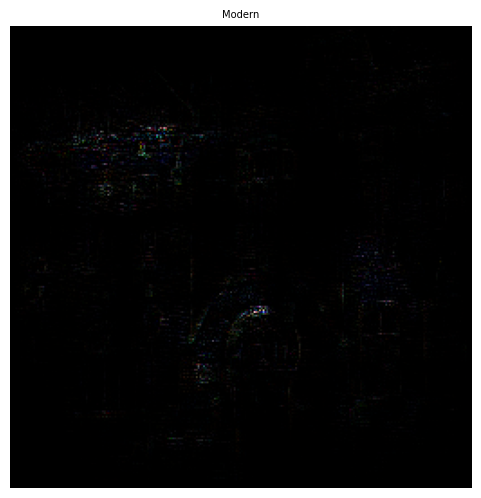

(1, 256, 256, 3)


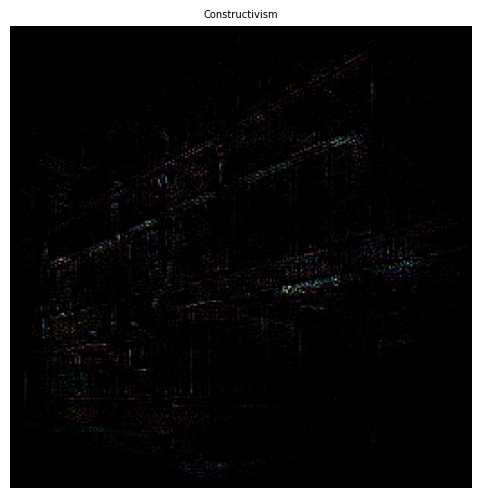

(1, 256, 256, 3)


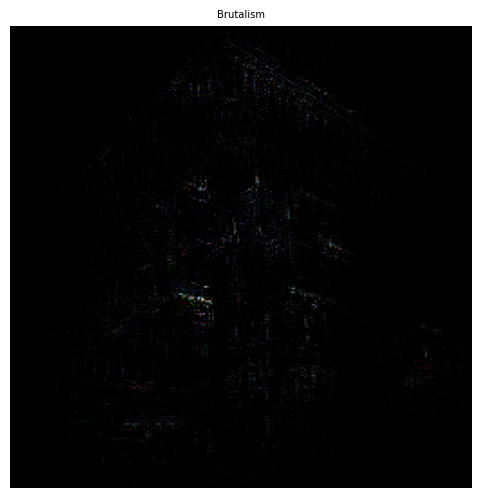

(1, 256, 256, 3)


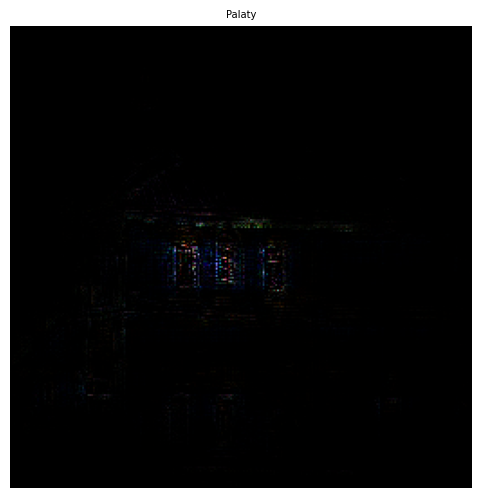

(1, 256, 256, 3)


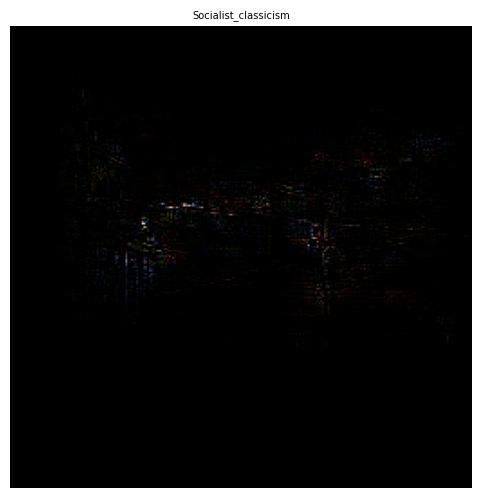

(1, 256, 256, 3)


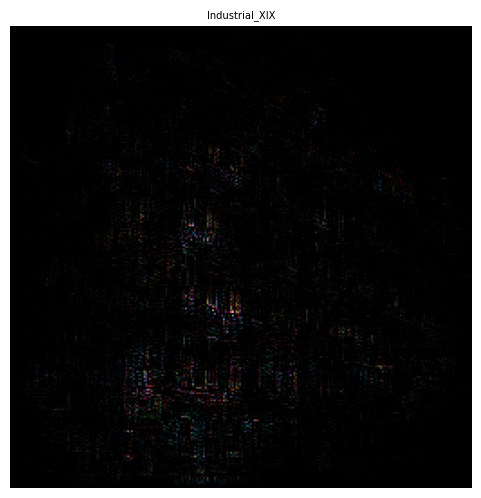

(1, 256, 256, 3)


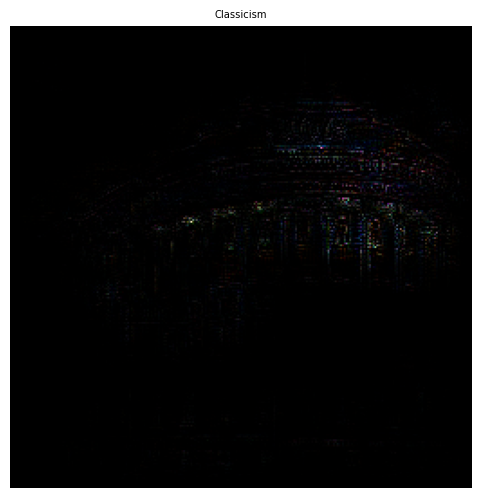

(1, 256, 256, 3)


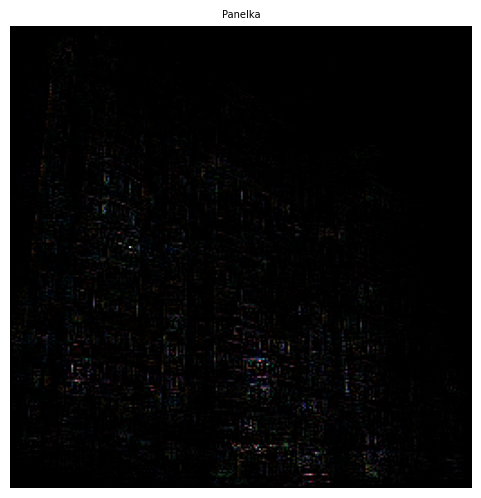

(1, 256, 256, 3)


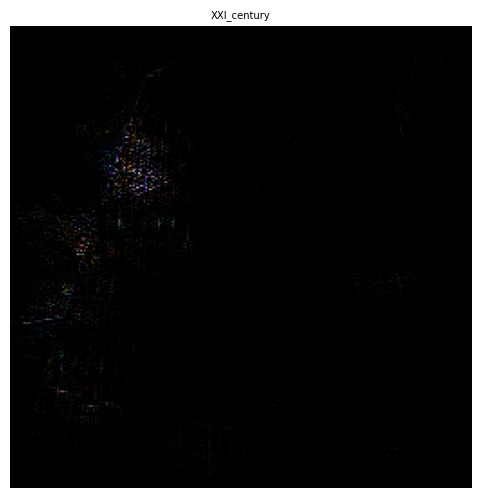

(1, 256, 256, 3)


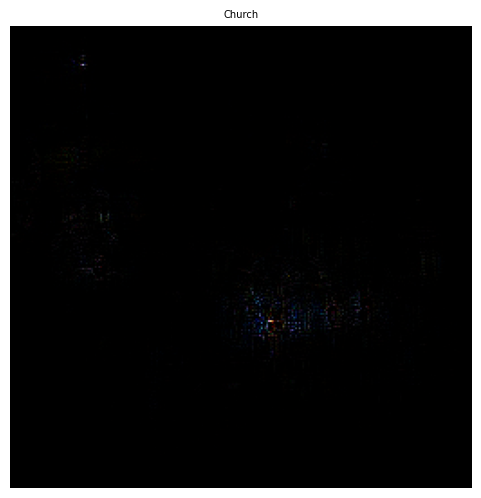

(1, 256, 256, 3)


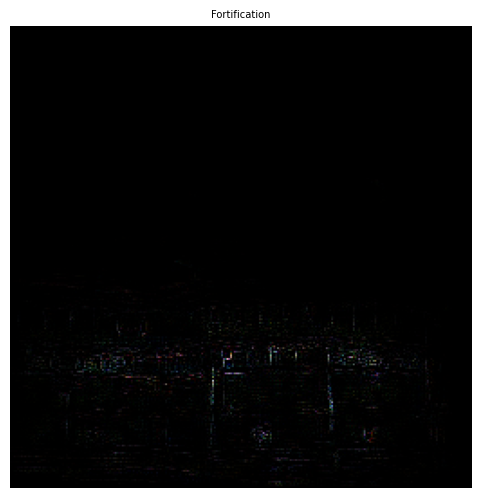

(1, 256, 256, 3)


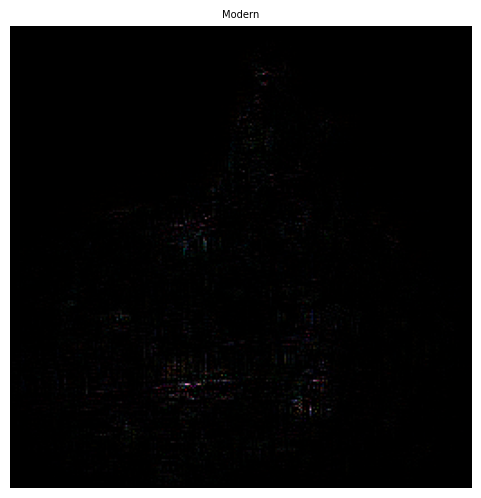

(1, 256, 256, 3)


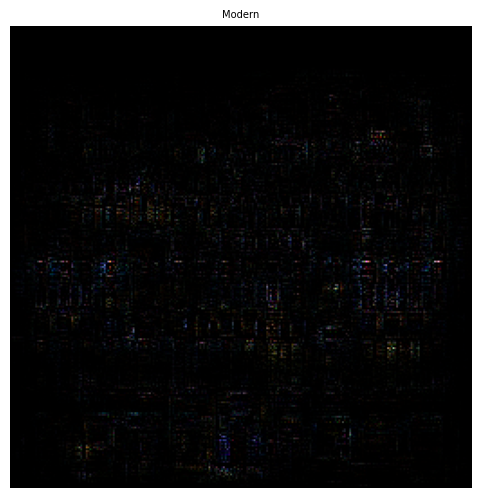

(1, 256, 256, 3)


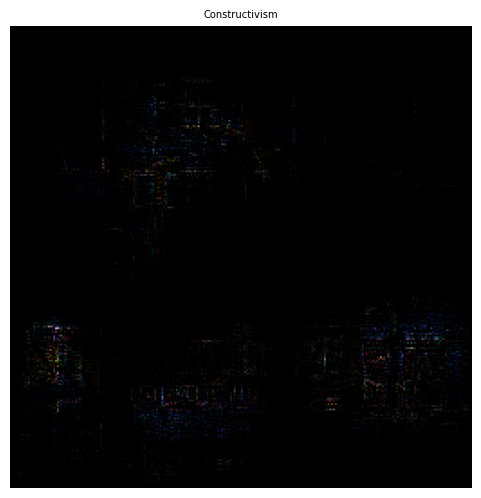

(1, 256, 256, 3)


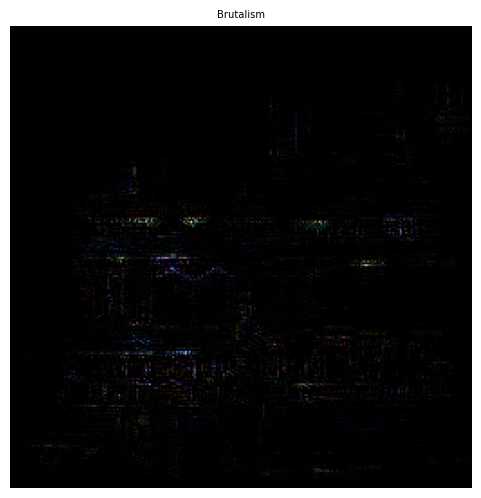

(1, 256, 256, 3)


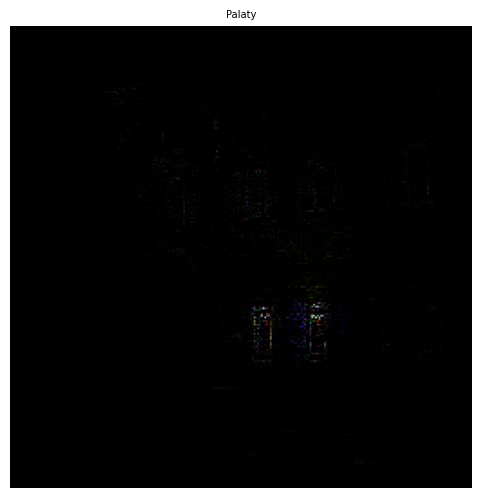

(1, 256, 256, 3)


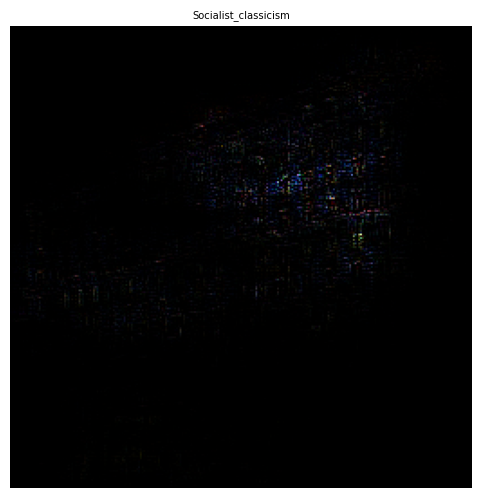

(1, 256, 256, 3)


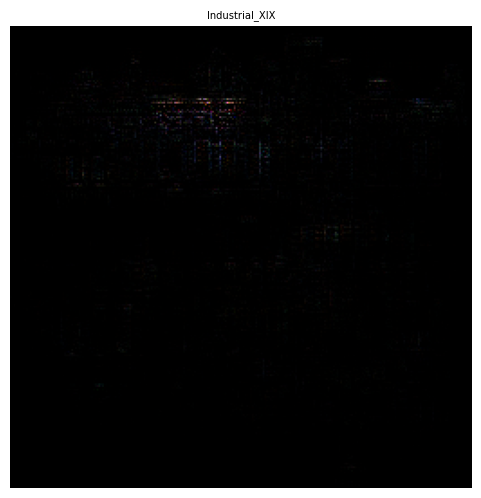

(1, 256, 256, 3)


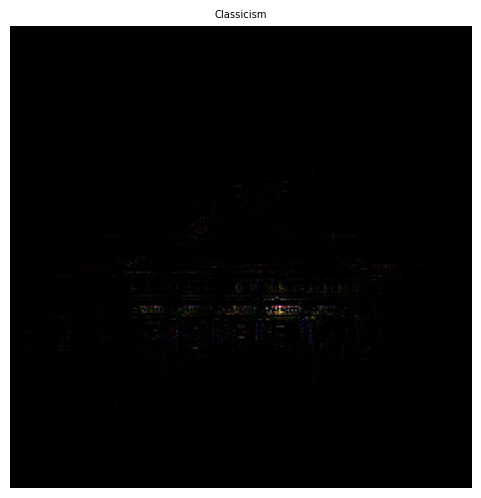

(1, 256, 256, 3)


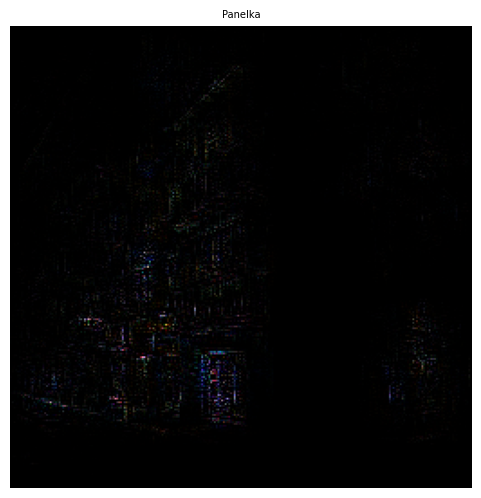

(1, 256, 256, 3)


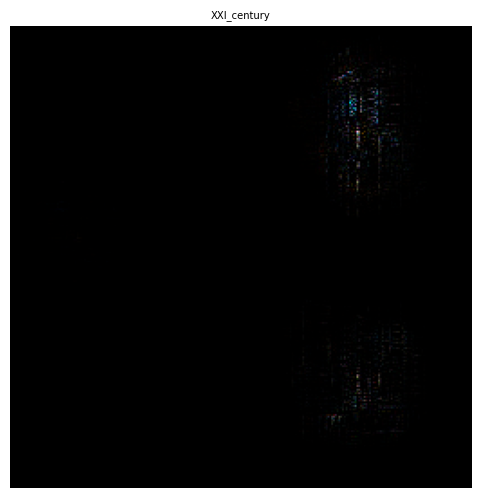

(1, 256, 256, 3)


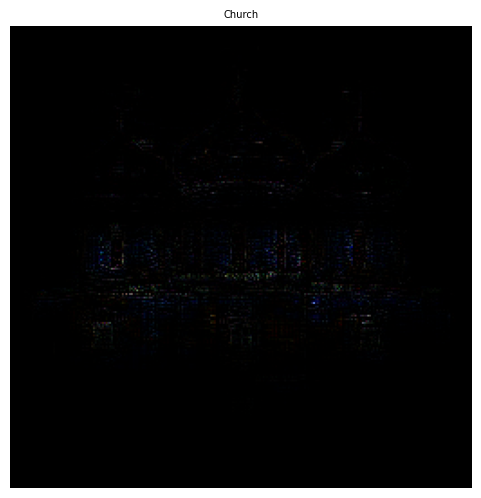

(1, 256, 256, 3)


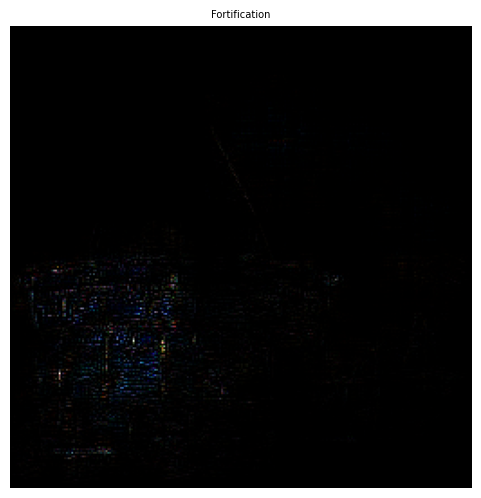

(1, 256, 256, 3)


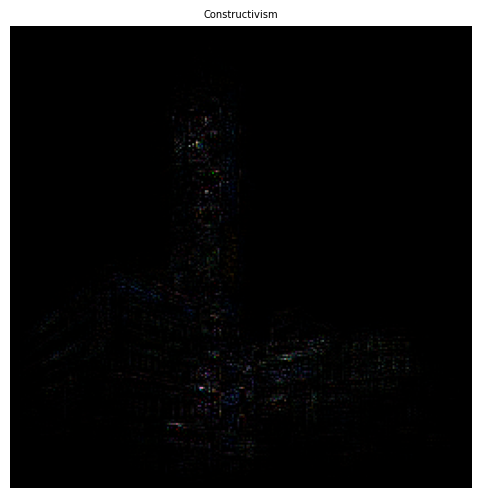

(1, 256, 256, 3)


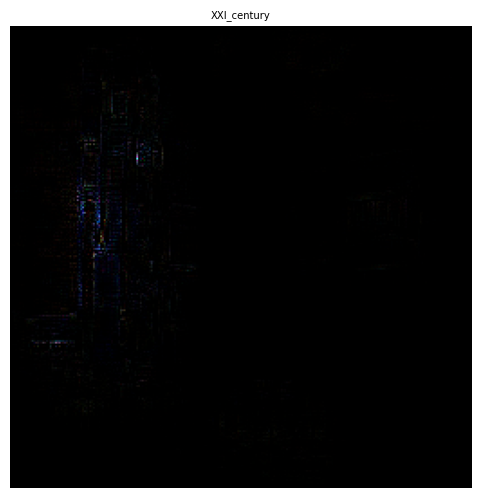

In [15]:
for i in range(len(test_way_list)):
    img = image.load_img(test_way_list[i], target_size=(256, 256))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = tf.convert_to_tensor(x, dtype=tf.float32)

    # Compute Guided Backpropagation gradients
    with tf.GradientTape() as tape:
        tape.watch(x)
        preds = model(x)
        class_idx = tf.argmax(preds[0])
        class_output = tf.gather(preds[0], class_idx)
    grads = tape.gradient(class_output, x)
    guided_backprop_grads = tf.cast(grads > 0, "float32") * tf.cast(x > 0, "float32") * grads
    print(guided_backprop_grads.shape)

    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2))
    

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    heatmap_r = cv2.resize(heatmap, (256, 256))
    heatmap_exp = np.expand_dims(heatmap_r, axis=0)
    heatmap_broadcasted = np.repeat(heatmap_exp[:, :, :, np.newaxis], 3, axis=-1)
    #img2 = cv2.imread(test_way_list[i])
    #INTENSITY = 0.8
    #heatmap = cv2.resize(heatmap, (256, 256))

    # Compute Guided Grad-CAM
    guided_grad_cam = guided_backprop_grads * heatmap_broadcasted

    # Overlay on original image
    guided_grad_cam = guided_grad_cam[0]  # Remove batch dimension
    guided_grad_cam = (guided_grad_cam - np.min(guided_grad_cam)) / (np.max(guided_grad_cam) - np.min(guided_grad_cam))

    plt.figure(figsize=(6, 6))
    plt.imshow(heatmap_r, alpha=0.8, cmap='jet')
    plt.imshow(img, alpha=0.5)
    plt.imshow(guided_grad_cam, alpha=1, cmap='gist_earth')
    plt.title(cl_list[i])
    plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 65ms/step


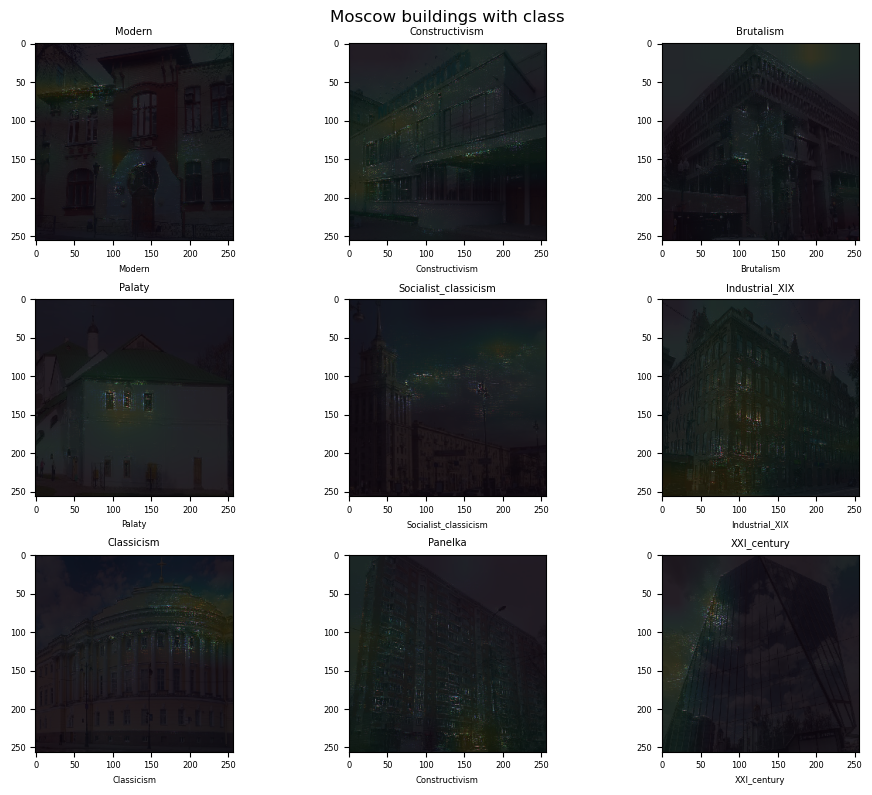

In [16]:
fig = plt.figure(figsize=(10, 8))
#sns.set_style('darkgrid')
plt.suptitle('Moscow buildings with class', size=12)

plt.rc('font', size=6) 
plt.rc('xtick', labelsize=6)    
plt.rc('ytick', labelsize=6) 

for i in range(9):
    fig.add_subplot(3, 3, i+1)

    img = image.load_img(test_way_list[i], target_size=(256, 256))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = tf.convert_to_tensor(x, dtype=tf.float32)

    predictions = base_model.predict(x)
    class_idpr = np.argmax(predictions[0])
    cl = pred_classes[class_idpr]

    # Compute Guided Backpropagation gradients
    with tf.GradientTape() as tape:
        tape.watch(x)
        preds = model(x)
        class_idx = tf.argmax(preds[0])
        class_output = tf.gather(preds[0], class_idx)
        

    grads = tape.gradient(class_output, x)
    guided_backprop_grads = tf.cast(grads > 0, "float32") * tf.cast(x > 0, "float32") * grads

    # Compute Grad-CAM
    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2)) 

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    heatmap_r = cv2.resize(heatmap, (256, 256))
    heatmap_exp = np.expand_dims(heatmap_r, axis=0)
    heatmap_broadcasted = np.repeat(heatmap_exp[:, :, :, np.newaxis], 3, axis=-1)
    #img2 = cv2.imread(test_way_list[i])
    #INTENSITY = 0.8
    #heatmap = cv2.resize(heatmap, (256, 256))

    # Compute Guided Grad-CAM
    guided_grad_cam = guided_backprop_grads * heatmap_broadcasted

    # Overlay on original image
    guided_grad_cam = guided_grad_cam[0]  # Remove batch dimension
    guided_grad_cam = (guided_grad_cam - np.min(guided_grad_cam)) / (np.max(guided_grad_cam) - np.min(guided_grad_cam))
    
    #heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
    
    plt.imshow(heatmap_r, alpha=0.8)
    plt.imshow(img, alpha=0.5)
    plt.imshow(guided_grad_cam, alpha=0.8, cmap='gist_earth')

    
    plt.xticks()
    plt.yticks()
    plt.xlabel(cl)

    plt.subplots_adjust(hspace = 0.2)
    plt.subplots_adjust(wspace = 0.2)
  #  plt.grid()
    plt.title(cl_list[i])
    plt.tight_layout()

# Guided Backpropogation

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


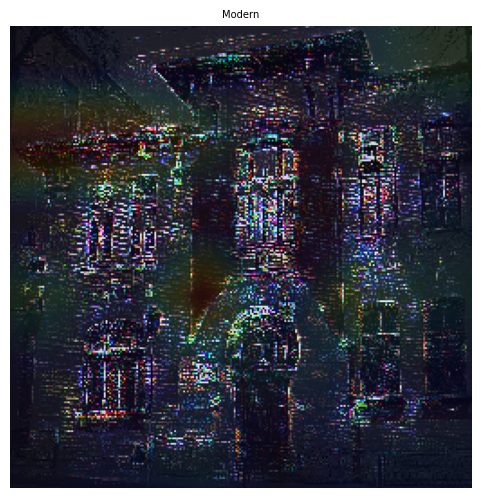

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


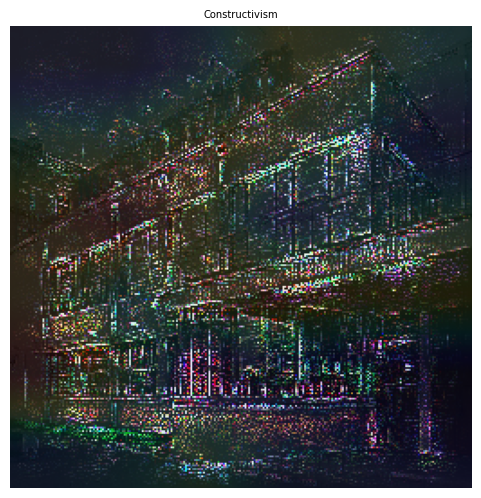

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


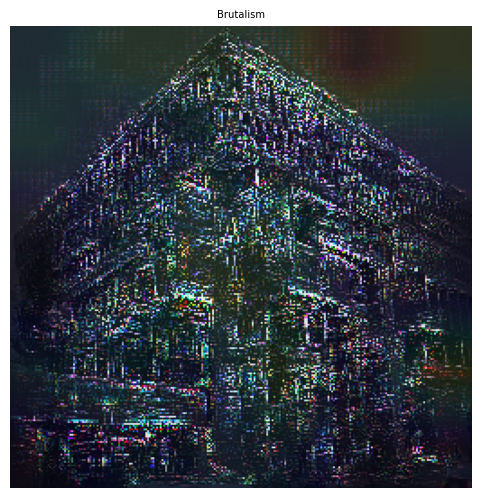

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


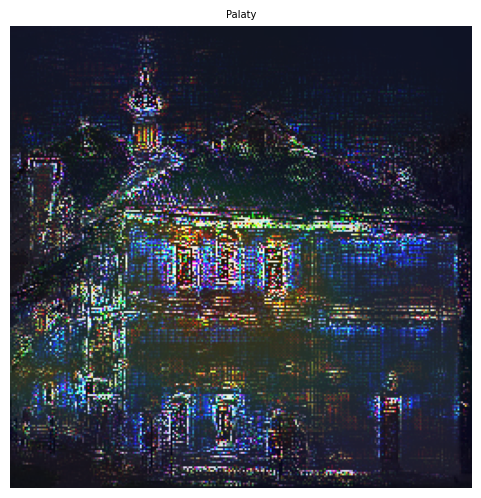

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


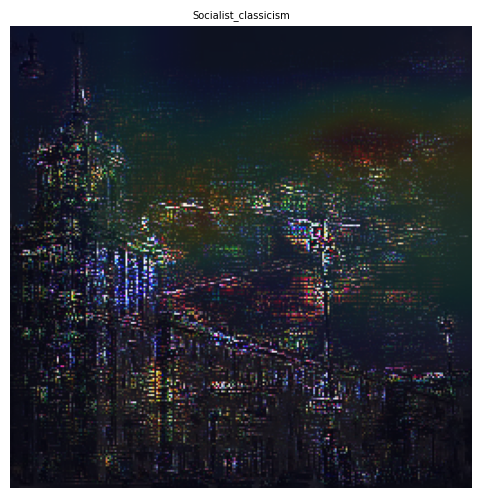

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


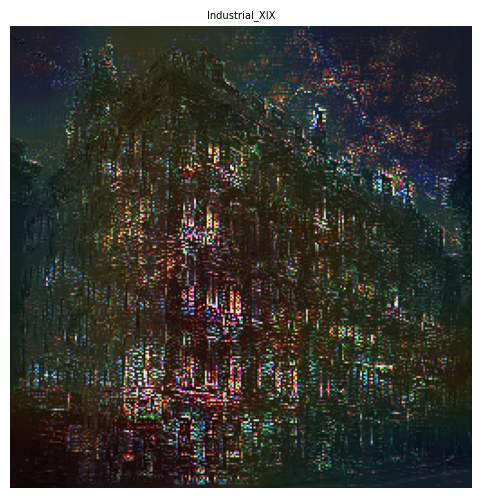

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


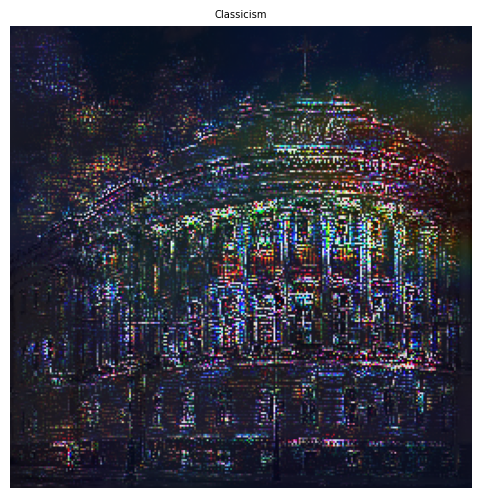

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


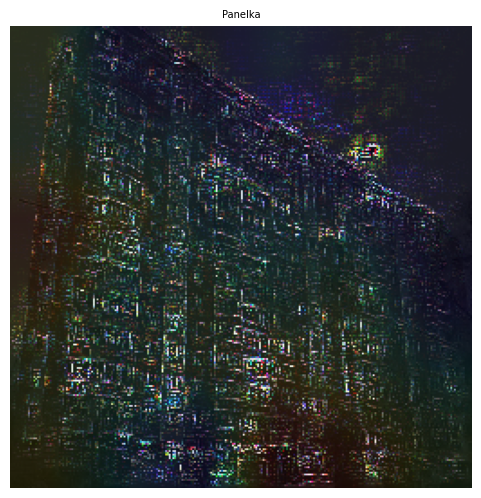

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


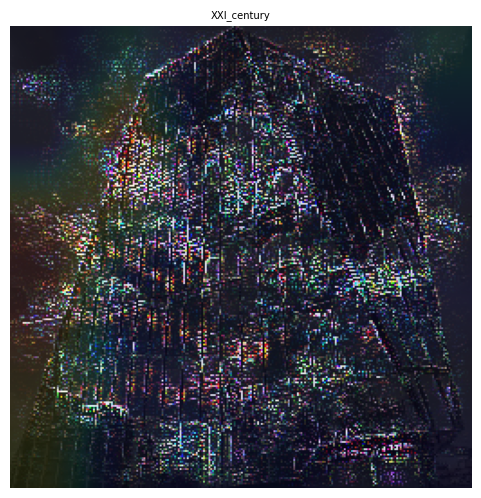

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


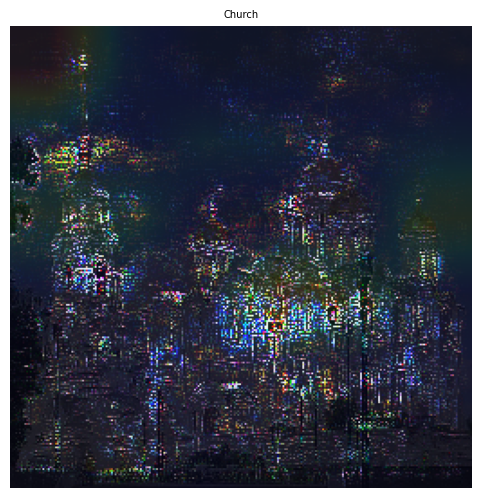

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


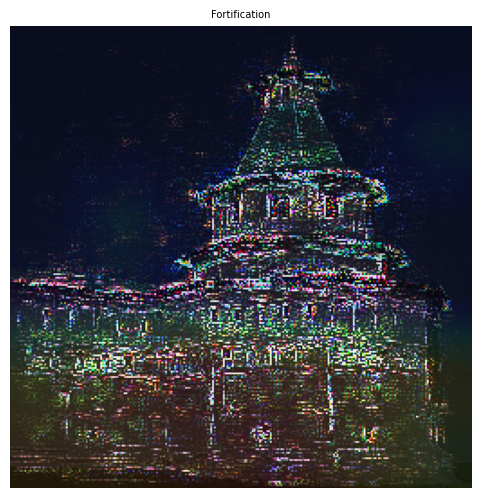

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


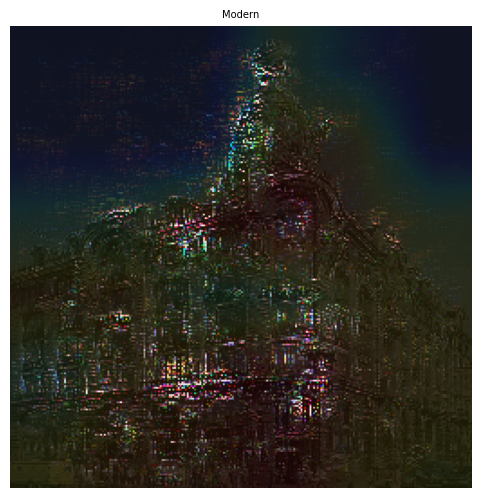

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


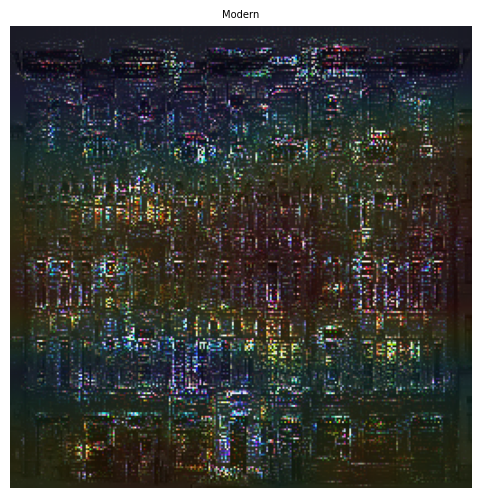

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


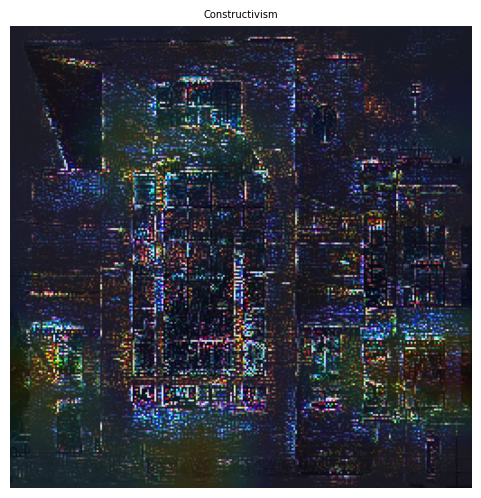

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


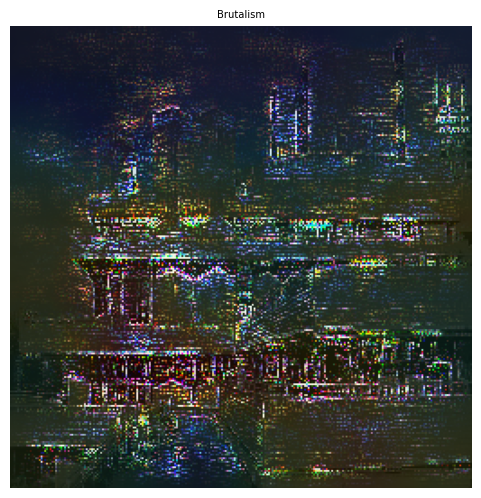

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


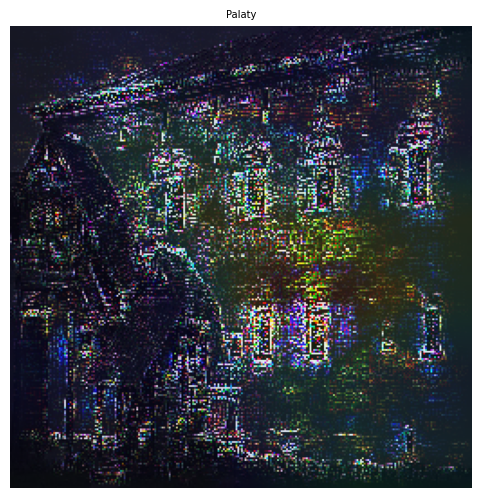

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


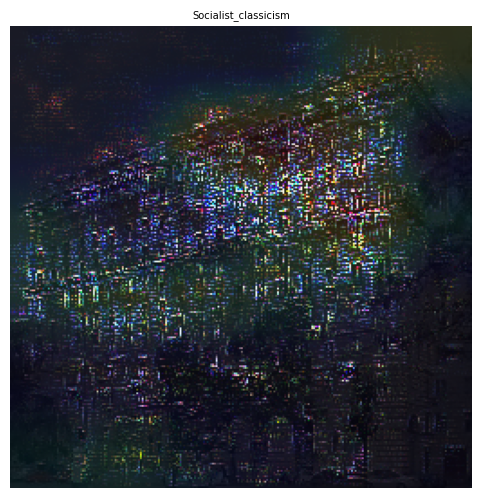

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


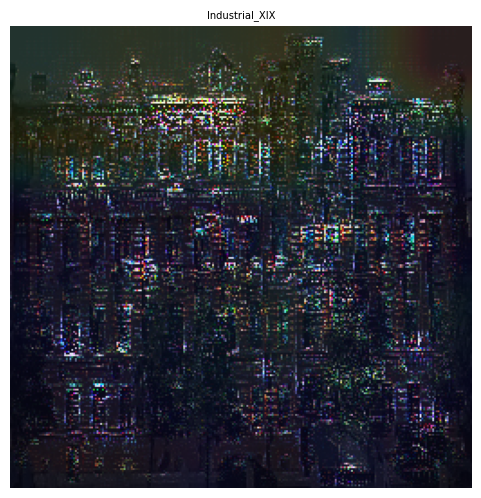

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


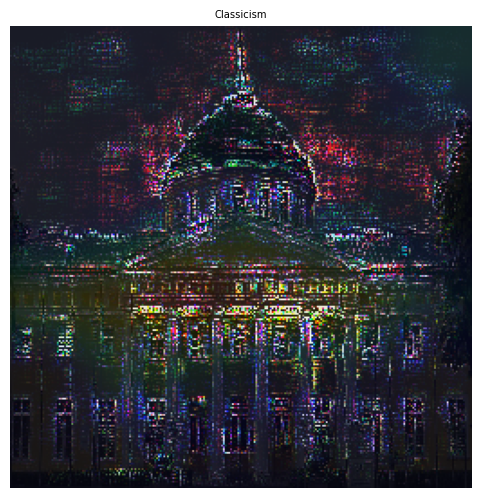

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


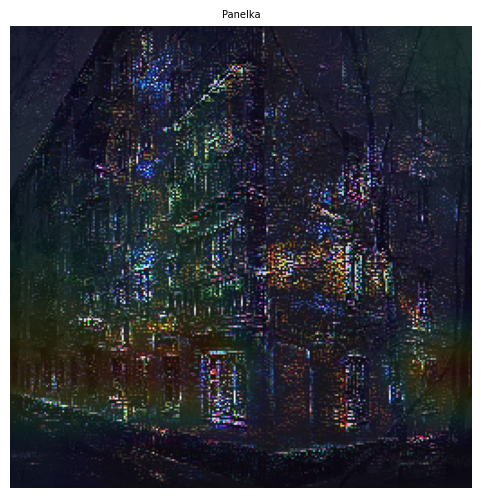

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


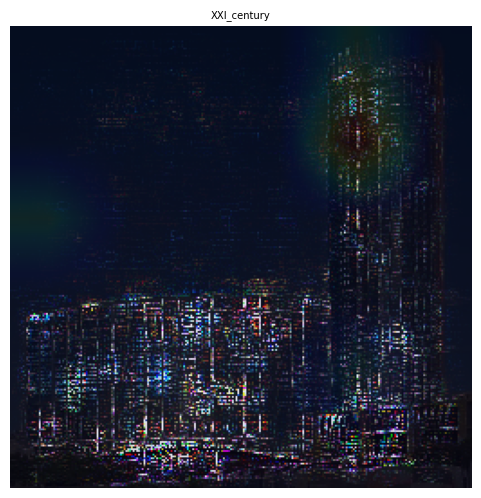

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


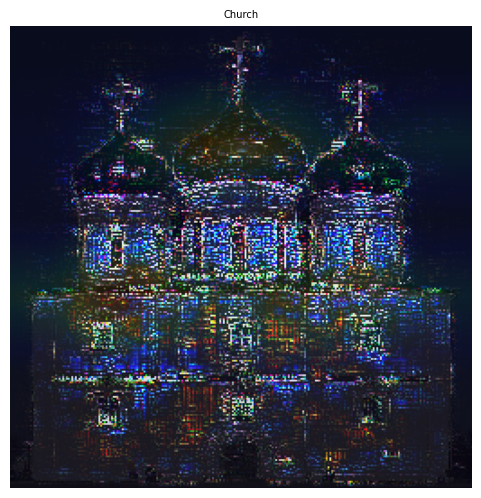

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


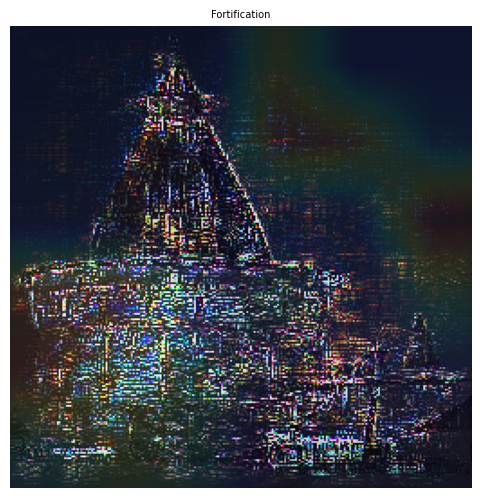

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


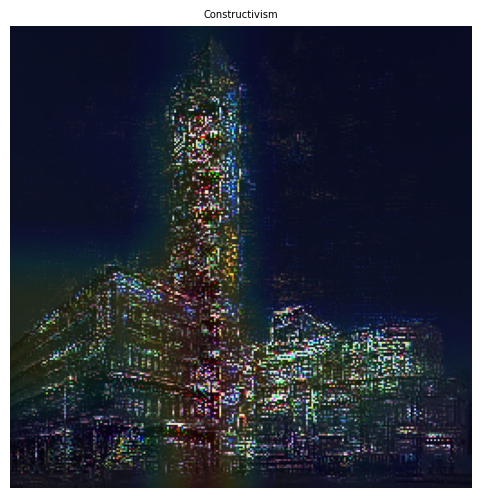

(1, 256, 256, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


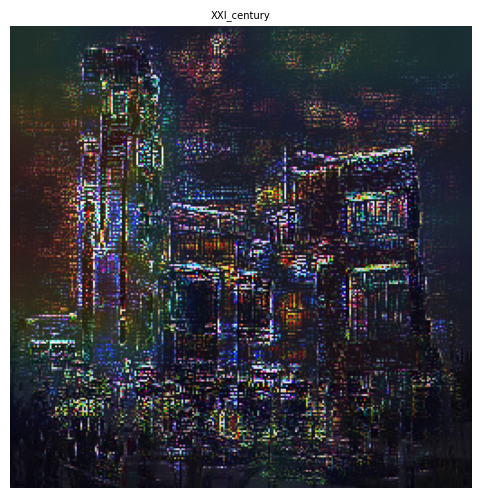

In [17]:
for i in range(len(test_way_list)):
    img = image.load_img(test_way_list[i], target_size=(256, 256))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = tf.convert_to_tensor(x, dtype=tf.float32)

    # Compute Guided Backpropagation gradients
    with tf.GradientTape() as tape:
        tape.watch(x)
        preds = model(x)
        class_idx = tf.argmax(preds[0])
        class_output = tf.gather(preds[0], class_idx)
    grads = tape.gradient(class_output, x)
    guided_backprop_grads = tf.cast(grads > 0, "float32") * tf.cast(x > 0, "float32") * grads
    print(guided_backprop_grads.shape)

    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2))
    

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    heatmap_r = cv2.resize(heatmap, (256, 256))
    heatmap_exp = np.expand_dims(heatmap_r, axis=0)
    heatmap_broadcasted = np.repeat(heatmap_exp[:, :, :, np.newaxis], 3, axis=-1)
    #img2 = cv2.imread(test_way_list[i])
    #INTENSITY = 0.8
    #heatmap = cv2.resize(heatmap, (256, 256))

    # Compute Guided Grad-CAM
    guided_grad_cam = guided_backprop_grads * heatmap_broadcasted

    # Overlay on original image
    guided_grad_cam = guided_grad_cam[0]  # Remove batch dimension
    guided_grad_cam = (guided_grad_cam - np.min(guided_grad_cam)) / (np.max(guided_grad_cam) - np.min(guided_grad_cam))

    plt.figure(figsize=(6, 6))
    plt.imshow(heatmap_r, alpha=0.8, cmap='jet')
    plt.imshow(img, alpha=0.5)
    plt.imshow(guided_backprop_grads[0]*255, alpha=0.8, cmap='gist_earth')
    plt.title(cl_list[i])
    plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 68ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 83ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 67ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 65ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 64ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


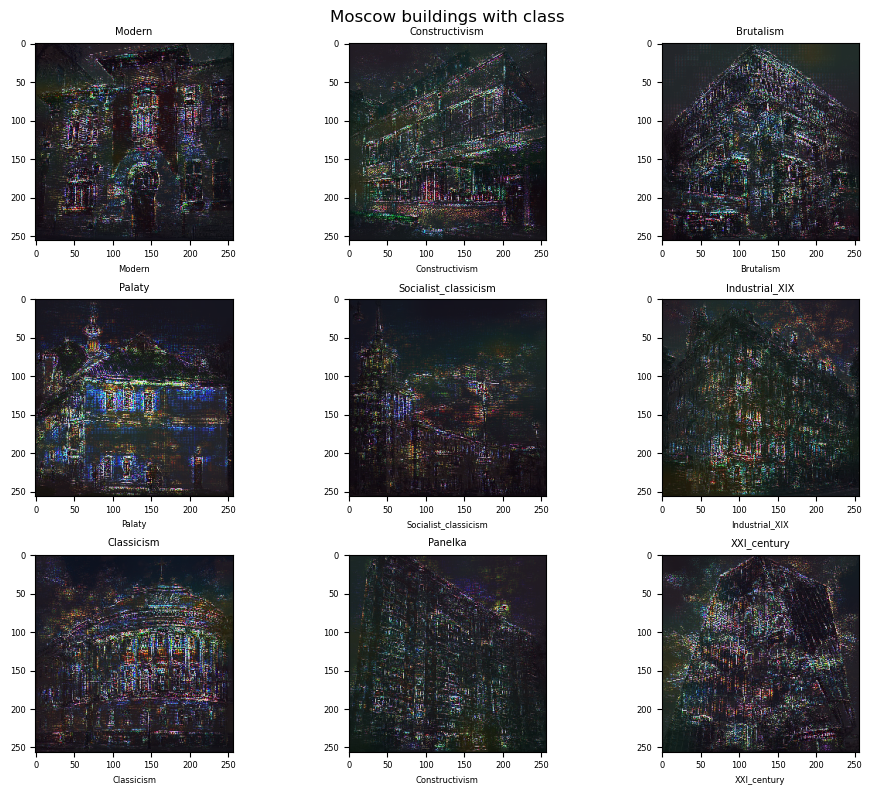

In [18]:
fig = plt.figure(figsize=(10, 8))
#sns.set_style('darkgrid')
plt.suptitle('Moscow buildings with class', size=12)

plt.rc('font', size=6) 
plt.rc('xtick', labelsize=6)    
plt.rc('ytick', labelsize=6) 

for i in range(9):
    fig.add_subplot(3, 3, i+1)

    img = image.load_img(test_way_list[i], target_size=(256, 256))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = tf.convert_to_tensor(x, dtype=tf.float32)

    predictions = base_model.predict(x)
    class_idpr = np.argmax(predictions[0])
    cl = pred_classes[class_idpr]

    # Compute Guided Backpropagation gradients
    with tf.GradientTape() as tape:
        tape.watch(x)
        preds = model(x)
        class_idx = tf.argmax(preds[0])
        class_output = tf.gather(preds[0], class_idx)
        

    grads = tape.gradient(class_output, x)
    guided_backprop_grads = tf.cast(grads > 0, "float32") * tf.cast(x > 0, "float32") * grads

    # Compute Grad-CAM
    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('conv2d_5')
        iterate = tf.keras.models.Model([model.inputs], [model.output, last_conv_layer.output])
        model_out, last_conv_layer = iterate(x)
        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)
        pooled_grads = K.mean(grads, axis=(0, 1, 2)) 

    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    heatmap = heatmap.reshape((6, 6))
    heatmap_r = cv2.resize(heatmap, (256, 256))
    heatmap_exp = np.expand_dims(heatmap_r, axis=0)
    heatmap_broadcasted = np.repeat(heatmap_exp[:, :, :, np.newaxis], 3, axis=-1)
    #img2 = cv2.imread(test_way_list[i])
    #INTENSITY = 0.8
    #heatmap = cv2.resize(heatmap, (256, 256))
    
    plt.imshow(heatmap_r, alpha=0.8)
    plt.imshow(img, alpha=0.5)
    plt.imshow(guided_backprop_grads[0]*255, alpha=0.8, cmap='gist_earth')

    
    plt.xticks()
    plt.yticks()
    plt.xlabel(cl)

    plt.subplots_adjust(hspace = 0.2)
    plt.subplots_adjust(wspace = 0.2)
    #plt.grid()
    plt.title(cl_list[i])
    plt.tight_layout()